# Find the central star of CTIO Data in November 2016
==================================================================================================

- author : Sylvie Dagoret-Campagne
- date   : January 23th 2017


Find the central star and cut the region around the central star of interest.


In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os

In [2]:
import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [3]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal

In [4]:
import bottleneck as bn  # numpy's masked median is slow...really slow (in version 1.8.1 and lower)
print 'bottleneck version',bn.__version__

bottleneck version 1.0.0


In [5]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [6]:
%load_ext Cython

In [7]:
from IPython.display import Image, display

In [8]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [9]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (4, 4),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [10]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

In [11]:
#inputdir="./processed_fitsimages"
inputdir="./processed_fitsimages"
object_name='HD60753'

In [12]:
outputdir="./cut_fitsimages"

In [13]:
ensure_dir(outputdir)

## Location of corrected images
----------------------------------

In [14]:
input_filelist=os.listdir(inputdir) 

In [15]:
if '.DS_Store' in input_filelist:
    input_filelist.remove('.DS_Store')
input_filelist=np.array(input_filelist)

In [16]:
print input_filelist[:5]

['imgbkgsub_HD60753_20170117_210.fits'
 'imgbkgsub_HD60753_20170117_211.fits'
 'imgbkgsub_HD60753_20170117_212.fits'
 'imgbkgsub_HD60753_20170117_213.fits'
 'imgbkgsub_HD60753_20170117_214.fits']


In [17]:
re.findall('^imgbkgsub_HD14943_20170117_([0-9]+).fits','imgbkgsub_HD14943_20170117_096.fits')

['096']

In [18]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [19]:
#%%cython

import numpy as np
import re

def MakeFileList(inputdir,input_filelist):
    """
    MakeFileList : Make The List of files to open
    =============
    """
    
#    import numpy as np
#    import re
    indexes_files= [] # global list
    filelist_fitsimages= []  # global list
    

    
    for file in input_filelist: # loop on directories, one per image       
            filename=inputdir+'/'+file
            if re.search('.*fits$',filename):  #example of filename filter
                num_str=re.findall('^imgbkgsub_HD60753_20170117_([0-9]+).fits',file)[0]
                index=int(num_str)
                filelist_fitsimages.append(filename)
                indexes_files.append(index)
    return indexes_files, filelist_fitsimages

In [20]:
indexes_files, filelist_fitsimages=MakeFileList(inputdir,input_filelist)   # Make the list

In [21]:
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [22]:
print indexes_files

[210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227
 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245
 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263
 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281
 282 283 284 285 286 287 288 289 290 291 292 293]


In [23]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [24]:
sorted_numbers=indexes_files[sorted_indexes]

In [25]:
print sorted_indexes

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49
 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74
 75 76 77 78 79 80 81 82 83]


In [26]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_indexes]

In [27]:
#sorted_files

## Build full filename
----------------------------

In [28]:
sorted_filenames=[]
for file in sorted_files:
    #fullfilename=os.path.join(inputdir,file)
    fullfilename=file
    sorted_filenames.append(fullfilename)

In [29]:
#sorted_filenames=np.array(sorted_filenames)
sorted_filenames=np.copy(sorted_files)

In [30]:
print sorted_filenames.shape

(84,)


## Acces to data of  images
----------------------------------

In [31]:
all_dates = []
all_airmass = []
all_images = []
all_titles = []
all_header = []
all_img = []

In [32]:
%%cython

import numpy as np
from astropy.io import fits

def BuildImages(sorted_filenames,sorted_numbers,object_name):
    """
    BuildRawImages
    ===============
    """

    
    all_dates = []
    all_airmass = []
    all_images = []
    all_titles = []
    all_header = []
   
    NBFILES=sorted_filenames.shape[0]

    for idx in range(NBFILES):  
        
        file=sorted_filenames[idx]    
        
        hdu_list=fits.open(file)
        header=hdu_list[0].header
        #print header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
    
        num=sorted_numbers[idx]
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        image_corr=hdu_list[0].data
        image=image_corr
        
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        all_images.append(image)
        all_titles.append(title)
        all_header.append(header)
        hdu_list.close()
        
    return all_dates,all_airmass,all_images,all_titles,all_header

In [33]:
all_dates,all_airmass,all_images,all_titles,all_header=BuildImages(sorted_files,sorted_numbers,object_name)

## Show images
-----------------------

In [34]:
len(all_images)

84

In [35]:
%%cython

import numpy as np
import matplotlib.pyplot as plt
    
def ShowImages(all_images,all_titles,object_name):
    """
    ShowRawImages: Show the raw images without background subtraction
    ==============
    """

    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/5)+1
    

    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMAGES):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_images[index],vmin=-10,vmax=100)
        axarr[iy,ix].set_title(all_titles[index])
    title='Images of '.format(object_name)
    plt.suptitle(title,size=16)        

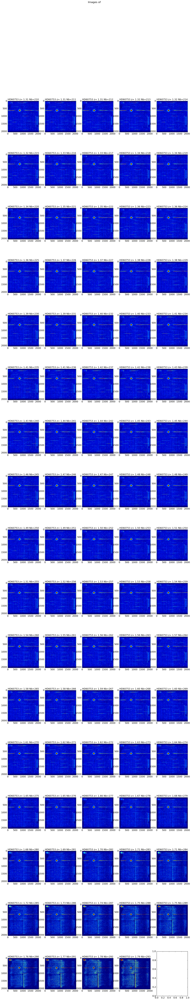

In [36]:
ShowImages(all_images,all_titles,object_name)

### Find the star locations
----------------------------

In [37]:
%%cython
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind

def ComputeStatImages(all_images):
    """
    ComputeStatImages: 
    ==============
    """
    
    img_mean=[]
    img_median=[]
    img_std=[]
    img_sources=[]
    img_=[]
    for image in all_images:
        mean, median, std = sigma_clipped_stats(image, sigma=10.0, iters=5)    
        img_mean.append(mean)
        img_median.append(median)
        img_std.append(std)
        sources = daofind(image - median, fwhm=3.0, threshold=500.*std)
        img_sources.append(sources)      
    return img_mean,img_median,img_std,img_sources

In [38]:
img_mean,img_median,img_std,img_sources=ComputeStatImages(all_images)

In [39]:
sel=3

In [40]:
thesource=img_sources[sel]
img_size=all_images[sel].shape

In [41]:
print thesource

 id   xcentroid     ycentroid   ...      peak          flux           mag       
--- ------------- ------------- ... ------------- ------------- ----------------
  1 277.272021292 104.123056789 ...  60639.444431 5.99509948011   -1.94449098498
  2 289.744521262 145.861186695 ...  23068.824527 2.60099958297   -1.03785070641
  3  1093.0515403 376.223343409 ... 10741.5697619 1.24607468357  -0.238860181433
  4 779.817506075 611.474270982 ... 60635.5312229 4.80534728293   -1.70431194911
  5 780.381077328  614.64711404 ... 60639.6096157 4.59721670721   -1.65623744087
  6 779.119831783 620.902962258 ... 60639.6485746 4.62250668173   -1.66219386899
  7 780.703823022 621.022149276 ... 60634.5500994 4.38554038985   -1.60505778779
  8 777.861868595 624.176356395 ... 60638.6781347 3.03084107971    -1.2039079125
  9 783.145243046 627.701241812 ... 60073.5441048 2.85397037384   -1.13862365132
 10 781.075459936 631.248992257 ... 60634.5865124 4.21883624893   -1.56298167221
 11 779.161287979 634.152396

In [42]:
x_star=thesource["xcentroid"]
y_star=thesource["ycentroid"]
points_set=np.array(zip(x_star,y_star))

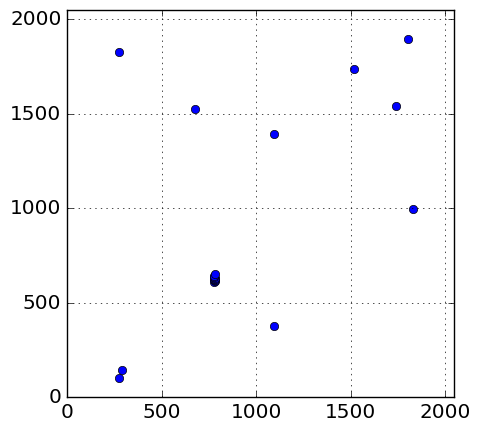

In [43]:
plt.figure(figsize=(5,5))
plt.plot(x_star,y_star,'o')
plt.xlim(0,img_size[1])
plt.ylim(0,img_size[0])
plt.grid(True)

### Search the main central star
----------------------------------

In [44]:
%%cython
import numpy as np

"""
Set of routine to find the right position of the main central star
"""
def distance(v1,v2): 
    return sum([(x-y)**2 for (x,y) in zip(v1,v2)])**(0.5)

def GetDistanceSum(thepoint, points_set):
    """
    Return the distance sum of the point thepoit to the set of points points_set
    """
    dist_sum=0
    for otherpoint in points_set:
        dist= distance(thepoint,otherpoint)
        dist_sum+=dist
    return dist_sum

def GetAllDistanceSum(all_points):
    """
    Return the set of the distance sum to other point for all points
    """
    all_distances = []
    for thepoint in all_points:
        dist=GetDistanceSum(thepoint, all_points)
        all_distances.append(dist)
    all_distances=np.array(all_distances)
    return all_distances
        

def GetCentralPosition( x_star, y_star):
    """
    Find the position of the point which minimise the distance sum wrt other points
    """
    points_set=np.array(zip(x_star,y_star))
    distances_sum=GetAllDistanceSum(points_set)
    central_pos_index=np.where(distances_sum==distances_sum.min())[0][0]
    return np.array([int(points_set[central_pos_index][1]),int(points_set[central_pos_index][0])])

In [45]:
GetCentralPosition( x_star, y_star)

array([631, 781])

### Special way to find the right center of the main star

In [52]:
positions_central = []
for source in img_sources:
    
    x_star=source["xcentroid"]
    y_star=source["ycentroid"]
    nb_points=x_star.shape[0]
    print nb_points
    if(nb_points!=0):
        position=GetCentralPosition(x_star,y_star)
        print position
    else:
        position = np.array([0.,0.])
        print position
    positions_central.append(position)

16
[634 783]
20
[630 781]
17
[635 780]
20
[631 781]
20
[636 779]
20
[631 781]
19
[628 782]
19
[633 781]
16
[637 778]
19
[649 778]
21
[636 780]
19
[629 780]
17
[643 777]
17
[638 779]
16
[633 777]
20
[637 776]
19
[635 776]
19
[636 778]
14
[644 775]
15
[634 777]
18
[635 775]
18
[636 775]
15
[641 774]
14
[638 774]
16
[636 776]
15
[642 773]
18
[638 777]
16
[637 772]
18
[633 775]
15
[641 773]
18
[634 774]
19
[637 774]
17
[646 772]
17
[640 771]
16
[635 773]
15
[642 769]
12
[647 769]
13
[637 771]
16
[638 770]
14
[634 767]
16
[639 771]
15
[636 771]
14
[645 769]
15
[644 767]
18
[640 770]
18
[640 770]
16
[645 770]
15
[641 769]
16
[646 766]
15
[641 768]
15
[638 769]
14
[641 766]
13
[639 767]
16
[639 768]
17
[638 767]
9
[641 767]
14
[642 765]
10
[632 764]
16
[641 764]
11
[640 765]
10
[641 765]
11
[638 758]
11
[639 759]
14
[643 765]
12
[630 760]
12
[638 760]
10
[638 758]
10
[636 759]
11
[631 760]
11
[631 759]
11
[637 756]
11
[636 759]
13
[640 755]
8
[635 759]
7
[636 755]
7
[631 757]
6
[633 760]
5
[6

### Cut the image
------------------

In [53]:
DeltaY=200
DeltaX=600

In [54]:
#%%cython

import numpy as np
import matplotlib.pyplot as plt
from photutils import CircularAperture

def ShowCenterImages(all_images,all_titles,object_name,positions_central):
    """
    ShowCenterImages: Show the raw images without background subtraction
    ==============
    """
    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/5)+1
    
    croped_images = []
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMAGES):
        ix=index%5
        iy=index/5
        y0=int(positions_central[index][0])
        x0=int(positions_central[index][1])
        
        #image_cut=all_images[index][y0-200:y0+200,x0-200,y0+200]
        theimage=all_images[index]
        #image_cut=theimage[y0-DeltaY:y0+DeltaY,x0-DeltaX:x0+DeltaX]
        image_cut=theimage[y0-DeltaY:y0+DeltaY,:]
        croped_images.append(image_cut)
        #aperture=CircularAperture([positions_central[index]], r=100.)
        im=axarr[iy,ix].imshow(image_cut,vmin=-10,vmax=200,origin='lower',interpolation='None')
        axarr[iy,ix].set_title(all_titles[index])
        #aperture.plot(color='red', lw=5.)
    title='Images of '.format(object_name)
    plt.suptitle(title,size=16) 
    return croped_images

/Users/dagoret-campagnesylvie/.local/lib/python2.7/site-packages/matplotlib/axes/_base.py:3040: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=-0.5, top=-0.5
  'bottom=%s, top=%s') % (bottom, top))


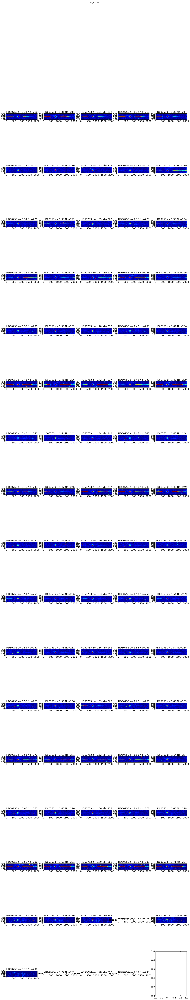

In [55]:
images_cut=ShowCenterImages(all_images,all_titles,object_name,positions_central)

#### Example of cut image
-------------------------

In [56]:
index=5
data=np.copy(images_cut[index])
w=20
ws=80
data[:,DeltaX-ws:DeltaX+ws]=0

In [57]:
yprofile=np.sum(data,axis=1)
xprofile=np.sum(data,axis=0)

In [58]:
y_center=np.where(yprofile==yprofile.max())[0][0]
print y_center

194


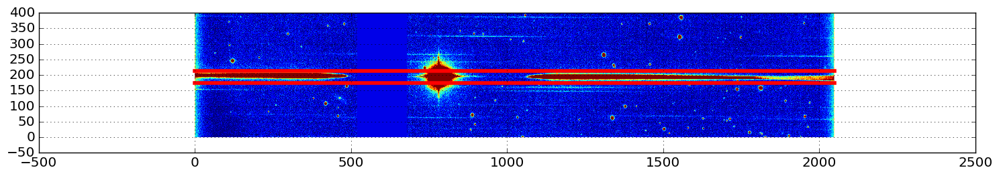

In [59]:
plt.figure(figsize=(18,18))
y0=int(positions_central[index][0])
x0=int(positions_central[index][1])
plt.imshow(data,vmin=-10,vmax=100,origin='lower',interpolation='None')
plt.plot([0,data.shape[1]],[y_center-w,y_center-w],'r-',lw=4)
plt.plot([0,data.shape[1]],[y_center+w,y_center+w],'r-',lw=4)
plt.grid(True)
plt.show()

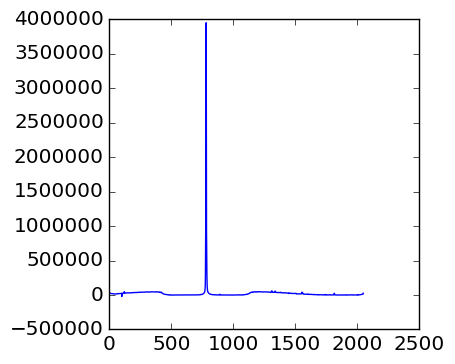

In [61]:
plt.plot(xprofile)

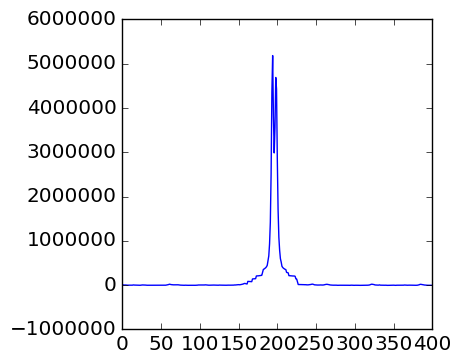

In [62]:
plt.plot(yprofile)

### Test rotation optimum
----------------------------

In [63]:
from scipy import stats 
from scipy import ndimage

In [64]:
RotationAngleOptimisation=False

In [65]:
rotation_angle_test=np.linspace(-5,5,100)
NBTESTS=rotation_angle_test.shape[0]
flux=np.zeros(NBTESTS)

In [66]:
if RotationAngleOptimisation:
    for index,angle in np.ndenumerate(rotation_angle_test):
        rotated_image=ndimage.interpolation.rotate(data,angle)
        imax,jmax = np.unravel_index(rotated_image.argmax(), rotated_image.shape)
        region=rotated_image[imax-w: imax+w,0:rotated_image.shape[1]]  # extract the region
        imax2,jmax2 = np.unravel_index(region.argmax(), region.shape)
        #region[:,jmax2-ws:jmax2+ws]=0 # suppress central star
        flux[index]=region.sum()
        #print 'index = {} angle={:2.4f} flux = {:2.0f}'.format(index,angle,flux[index])

In [67]:
if RotationAngleOptimisation:
    plt.plot(rotation_angle_test,flux)

In [68]:
if RotationAngleOptimisation:
    dflux=flux.max()-flux
    plt.plot(rotation_angle_test,dflux)

### prepare outputfilename

In [69]:
newfullfilenames=[]
for idx,file in np.ndenumerate(sorted_files):
    short_infilename=file.split("/")[2]
    short_partfilename=re.findall('^imgbkgsub_(.*)',short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

### Save outputfilename

In [70]:
for idx,file in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_cut[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(file,clobber=True)

In [ ]:
!ls

In [ ]:
# !ls -l cut_fitsimages